# Wizualizacje

## Pandas visualisations

In [1]:
import pandas as pd
import numpy as np
df = pd.DataFrame(np.abs(np.random.randn(10,4)), index=pd.date_range("18/11/2024", periods=10), columns=["A", "B", "C", "D"])
df

,A,B,C,D
2024-11-18,1.437914,0.166272,0.467135,0.304459
2024-11-19,0.785136,0.713017,0.138755,0.097166
2024-11-20,1.746948,0.010765,0.141576,0.301062
2024-11-21,1.630690,0.039306,0.010504,0.686103
2024-11-22,1.005227,0.059038,0.513319,0.680728
2024-11-23,1.642550,1.189845,0.355495,0.594071
2024-11-24,1.398214,0.374605,0.332218,1.077292
2024-11-25,0.503067,0.959301,0.629283,0.618750
2024-11-26,0.765665,0.700706,1.569049,0.551668
2024-11-27,0.451647,0.596000,1.314183,0.264895


<AxesSubplot: >

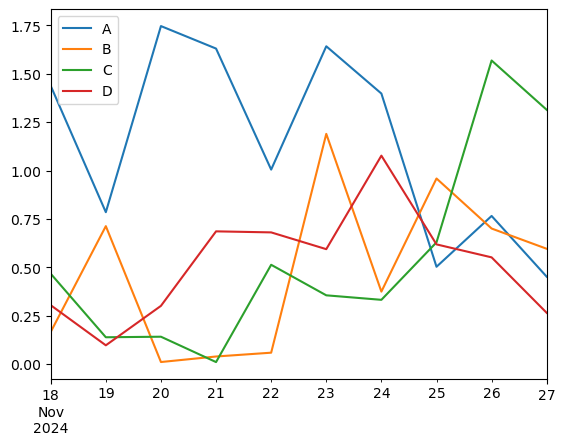

In [2]:
#wykres liniowy
df.plot()

<AxesSubplot: >

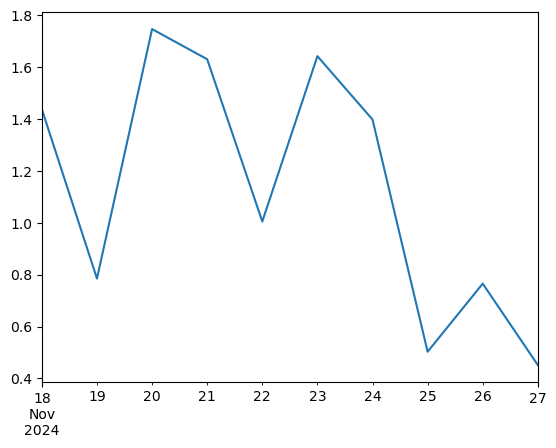

In [3]:
df.A.plot()

<AxesSubplot: >

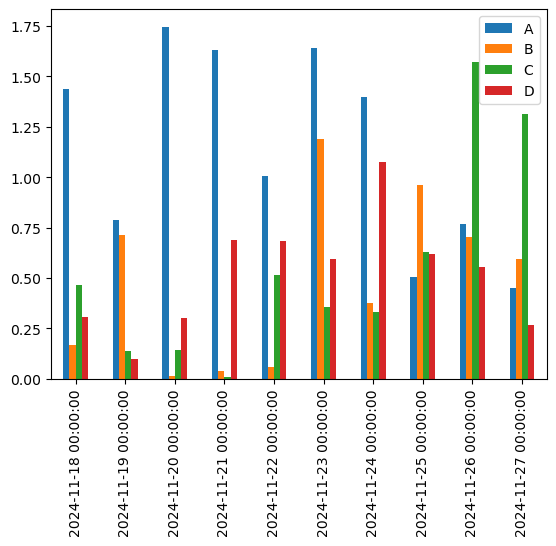

In [4]:
#wykres słupkowy
df.plot.bar()

<AxesSubplot: >

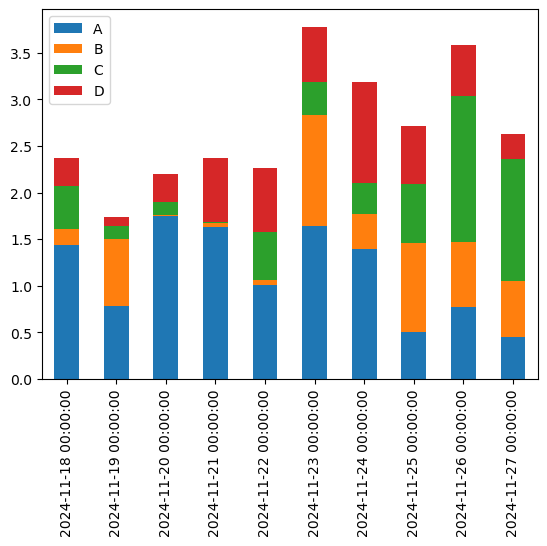

In [5]:
df.plot.bar(stacked=True)

<AxesSubplot: >

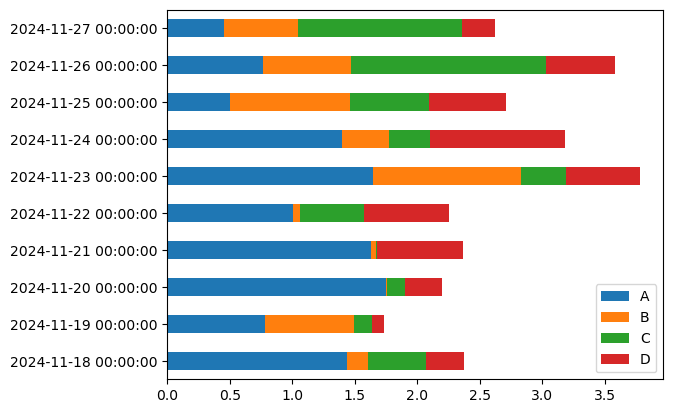

In [6]:
df.plot.barh(stacked=True)

<AxesSubplot: xlabel='A'>

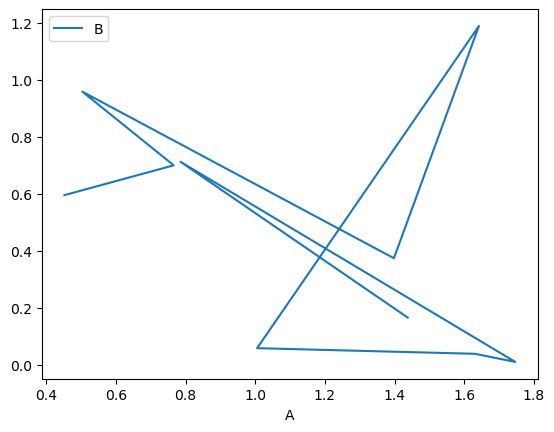

In [7]:
df.plot(x="A", y="B") #x nie jest indeksem

<AxesSubplot: ylabel='Frequency'>

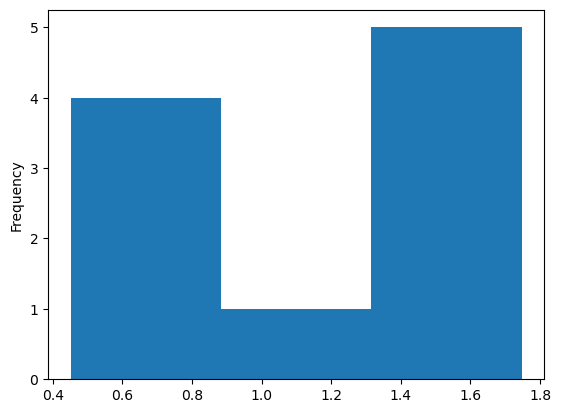

In [8]:
#histogram
df.A.plot.hist(bins=3)

<AxesSubplot: >

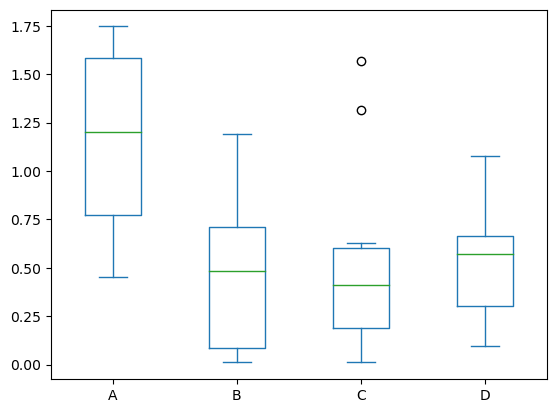

In [9]:
#wykres pudełkowy
df.plot.box()

<AxesSubplot: >

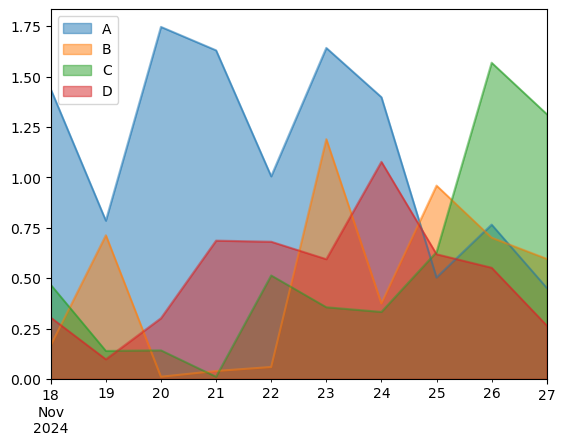

In [10]:
#wykres powierzchniowy
df.plot.area(stacked=False)

<AxesSubplot: xlabel='A', ylabel='B'>

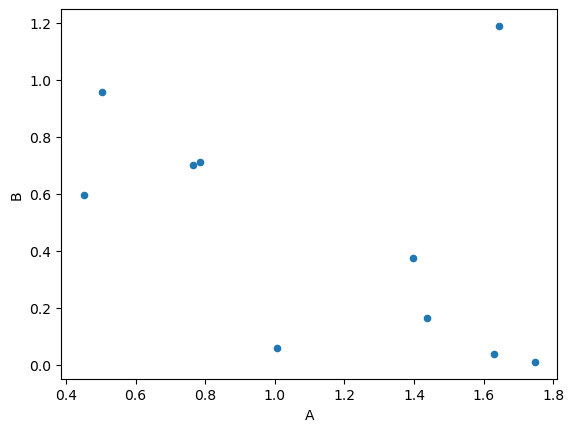

In [11]:
#wykres punktowy
df.plot.scatter(x="A", y="B")

<AxesSubplot: ylabel='A'>

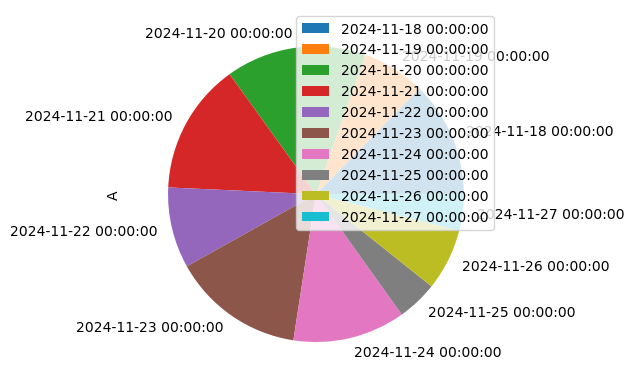

In [12]:
#wykres kołowy
df.plot.pie(y="A")

## Matplotlib

In [13]:
import matplotlib.pyplot as plt
import matplotlib
%matplotlib inline

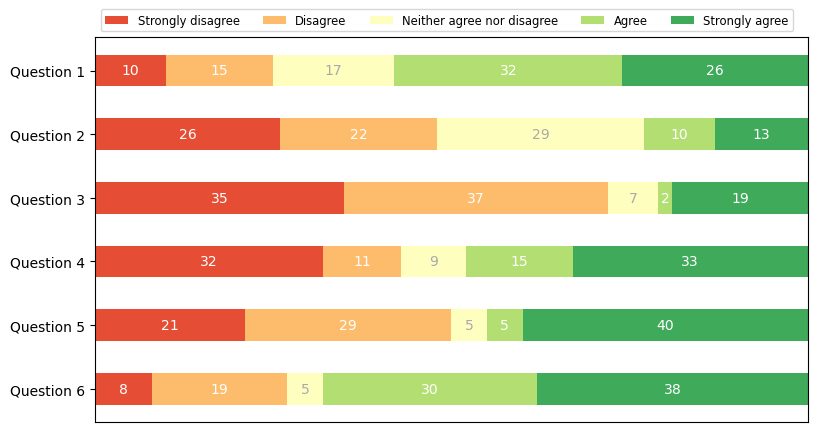

In [14]:
import matplotlib.pyplot as plt
import numpy as np

category_names = ['Strongly disagree', 'Disagree',
                  'Neither agree nor disagree', 'Agree', 'Strongly agree']
results = {
    'Question 1': [10, 15, 17, 32, 26],
    'Question 2': [26, 22, 29, 10, 13],
    'Question 3': [35, 37, 7, 2, 19],
    'Question 4': [32, 11, 9, 15, 33],
    'Question 5': [21, 29, 5, 5, 40],
    'Question 6': [8, 19, 5, 30, 38]
}


def survey(results, category_names):
    """
    Parameters
    ----------
    results : dict
        A mapping from question labels to a list of answers per category.
        It is assumed all lists contain the same number of entries and that
        it matches the length of *category_names*.
    category_names : list of str
        The category labels.
    """
    labels = list(results.keys())
    data = np.array(list(results.values()))
    data_cum = data.cumsum(axis=1)
    category_colors = plt.colormaps['RdYlGn'](
        np.linspace(0.15, 0.85, data.shape[1]))

    fig, ax = plt.subplots(figsize=(9.2, 5))
    ax.invert_yaxis()
    ax.xaxis.set_visible(False)
    ax.set_xlim(0, np.sum(data, axis=1).max())

    for i, (colname, color) in enumerate(zip(category_names, category_colors)):
        widths = data[:, i]
        starts = data_cum[:, i] - widths
        rects = ax.barh(labels, widths, left=starts, height=0.5,
                        label=colname, color=color)

        r, g, b, _ = color
        text_color = 'white' if r * g * b < 0.5 else 'darkgrey'
        ax.bar_label(rects, label_type='center', color=text_color)
    ax.legend(ncols=len(category_names), bbox_to_anchor=(0, 1),
              loc='lower left', fontsize='small')

    return fig, ax


survey(results, category_names)
plt.show()

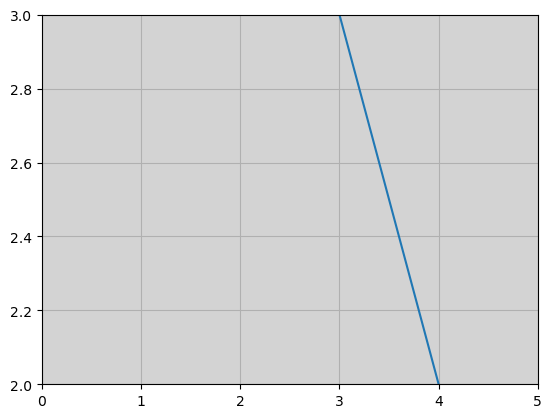

In [15]:
#pierwszy wykres

x = [1,2,3,4,5]
y = [5,4,3,2,1]

fig, ax = plt.subplots() # fig - ramka na wizualizacje, ax - wykresy

ax.plot(x, y) #wykres liniowy

ax.grid() #siatka
ax.set_facecolor("lightgray") #https://matplotlib.org/stable/gallery/color/color_demo.html#sphx-glr-gallery-color-color-demo-py

ax.set_xlim(0,5) #zmiana zakresu wykresu
ax.set_ylim(2,3)

plt.show() # pokaż rysunek

In [16]:
weather = pd.read_csv("ML-datasets-master/weather.csv", parse_dates=["date"], index_col="date")
weather.info()
weather.head()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1461 entries, 2012-01-01 to 2015-12-31
Data columns (total 5 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   precipitation  1461 non-null   float64
 1   temp_max       1461 non-null   float64
 2   temp_min       1461 non-null   float64
 3   wind           1461 non-null   float64
 4   weather        1461 non-null   object 
dtypes: float64(4), object(1)
memory usage: 68.5+ KB


,precipitation,temp_max,temp_min,wind,weather
date,,,,,
2012-01-01,0.0,12.8,5.0,4.7,drizzle
2012-01-02,10.9,10.6,2.8,4.5,rain
2012-01-03,0.8,11.7,7.2,2.3,rain
2012-01-04,20.3,12.2,5.6,4.7,rain
2012-01-05,1.3,8.9,2.8,6.1,rain


<Figure size 640x480 with 0 Axes>

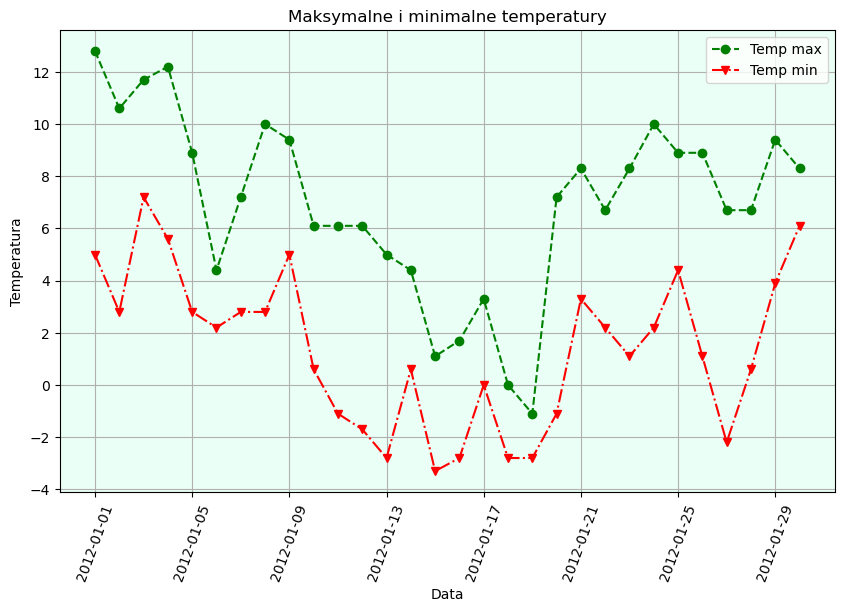

In [17]:
plt.figure(figsize=(8, 6), dpi=80) #rozmiar obrazka w nowym oknie - po zapisaniu
matplotlib.rcParams["figure.figsize"] = [10,6] # wielkość wyświetlanego obrazka w notebooku

fig, ax = plt.subplots()

ax.plot(weather.index[:30], weather.temp_max[:30], marker="o", linestyle="--", color="green", label="Temp max")
#https://matplotlib.org/stable/api/markers_api.html
#https://matplotlib.org/stable/gallery/lines_bars_and_markers/linestyles.html
ax.plot(weather.index[:30], weather.temp_min[:30], marker="v", linestyle="-.", color="red", label="Temp min")

ax.grid() #siatka
ax.set_facecolor("#eafff5")
ax.xaxis.set_tick_params(rotation=70)

ax.set_xlabel("Data")
ax.set_ylabel("Temperatura")
ax.set_title("Maksymalne i minimalne temperatury")

plt.legend()

plt.show()

In [18]:
#zapisywanie obrazka
fig.savefig("obraz1.png")

In [19]:
fig.savefig("obraz1.jpg", format="jpg", dpi=800)

In [20]:
austin_weather = pd.read_csv("ML-datasets-master/austin_weather.csv", parse_dates=["Date"], index_col="Date", na_values="T")
austin_weather.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1319 entries, 2013-12-21 to 2017-07-31
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   TempHighF                   1319 non-null   int64  
 1   TempAvgF                    1319 non-null   int64  
 2   TempLowF                    1319 non-null   int64  
 3   DewPointHighF               1319 non-null   object 
 4   DewPointAvgF                1319 non-null   object 
 5   DewPointLowF                1319 non-null   object 
 6   HumidityHighPercent         1319 non-null   object 
 7   HumidityAvgPercent          1319 non-null   object 
 8   HumidityLowPercent          1319 non-null   object 
 9   SeaLevelPressureHighInches  1319 non-null   object 
 10  SeaLevelPressureAvgInches   1319 non-null   object 
 11  SeaLevelPressureLowInches   1319 non-null   object 
 12  VisibilityHighMiles         1319 non-null   object 
 13  VisibilityAvgMi

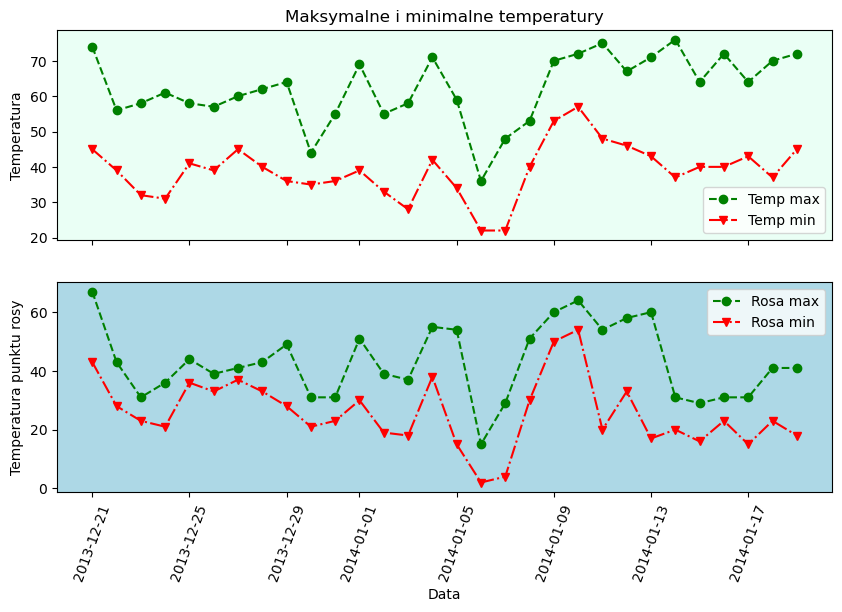

In [24]:
fig, ax = plt.subplots(2, 1, sharex=True) #liczba wierszy, liczba kolumn

ax[0].plot(austin_weather.index[:30], austin_weather.TempHighF[:30], marker="o", linestyle="--", color="green", label="Temp max")
ax[0].plot(austin_weather.index[:30], austin_weather.TempLowF[:30], marker="v", linestyle="-.", color="red", label="Temp min")

ax[1].plot(austin_weather.index[:30], austin_weather.DewPointHighF[:30].astype(float), marker="o", linestyle="--", color="green", label="Rosa max")
ax[1].plot(austin_weather.index[:30], austin_weather.DewPointLowF[:30].astype(float), marker="v", linestyle="-.", color="red", label="Rosa min")


ax[0].set_facecolor("#eafff5")
ax[1].set_facecolor("lightblue")
ax[1].xaxis.set_tick_params(rotation=70)

ax[1].set_xlabel("Data")
ax[0].set_ylabel("Temperatura")
ax[1].set_ylabel("Temperatura punktu rosy")
ax[0].set_title("Maksymalne i minimalne temperatury")

ax[0].legend(loc="best")
ax[1].legend()

plt.show()

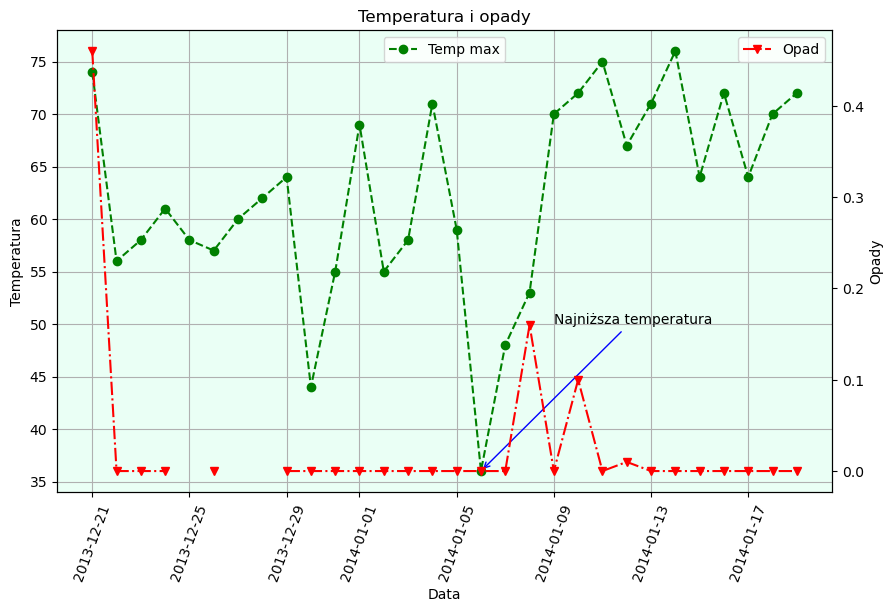

In [27]:
# zmienna oś y

fig, ax = plt.subplots()

ax.plot(austin_weather.index[:30], austin_weather.TempHighF[:30], marker="o", linestyle="--", color="green", label="Temp max")

ax2 = ax.twinx() #tworzenie wykresu o wspólnej osi X i różnej y
ax2.plot(austin_weather.index[:30], austin_weather.PrecipitationSumInches[:30], marker="v", linestyle="-.", color="red", label="Opad")

ax.grid() #siatka
ax.set_facecolor("#eafff5")
ax.xaxis.set_tick_params(rotation=70)

ax.set_xlabel("Data")
ax.set_ylabel("Temperatura")
ax2.set_ylabel("Opady")
ax.set_title("Temperatura i opady")

#anotacje
ax.annotate("Najniższa temperatura", xy=[austin_weather.TempHighF[:30].idxmin(), austin_weather.TempHighF[:30].min()],
            xytext=[pd.Timestamp("2014-01-09"), 50], arrowprops={"arrowstyle": "->", "color": "blue"})


ax.legend(loc="upper center")
ax2.legend(loc="best")

plt.show()

In [28]:
population = pd.read_csv("ML-datasets/population.csv", index_col="City")
population.head()
#population.info()

,Country or Area,Year,Area,Sex,City type,Record Type,Reliability,Source Year,Value,Value Footnotes
City,,,,,,,,,,
Bialystok,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,294362,"1,2"
Bielsko-Biala,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,170005,"1,2"
Bydgoszcz,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,352870,"1,2"
Bytom,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,167359,"1,2"
Chorzów,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,108205,"1,2"


In [31]:
#tworzenie osob
grupy = population.groupby("Sex")
print(grupy.groups)

#display(grupy.get_group("Female")) #tworzenie nowego dataframe'a z danej grupy

#lista_grup = []
#for x in grupy.groups:
#    lista_grup.append(grupy.get_group(x))
# both, female, male = lista_grup

both, female, male = [grupy.get_group(x) for x in grupy.groups]

{'Both Sexes': ['Bialystok', 'Bielsko-Biala', 'Bydgoszcz', 'Bytom', 'Chorzów', 'Czestochowa', 'Dabrowa Górnicza', 'Elblag', 'Gdansk', 'Gdynia', 'Gliwice', 'Gorzów Wielkopolski', 'Grudziadz', 'Jastrzebie-Zdrój', 'Kalisz', 'Katowice', 'Kielce', 'Koszalin', 'Kraków', 'Legnica', 'Lódz', 'Lublin', 'Olsztyn', 'Opole', 'Plock', 'Poznan', 'Radom', 'Ruda Slaska', 'Rybnik', 'Rzeszów', 'Slupsk', 'Sosnowiec', 'Szczecin', 'Tarnów', 'Torun', 'Tychy', 'Walbrzych', 'WARSZAWA', 'Wloclawek', 'Wroclaw', 'Zabrze', 'Zielona Góra'], 'Female': ['Bialystok', 'Bielsko-Biala', 'Bydgoszcz', 'Bytom', 'Chorzów', 'Czestochowa', 'Dabrowa Górnicza', 'Elblag', 'Gdansk', 'Gdynia', 'Gliwice', 'Gorzów Wielkopolski', 'Grudziadz', 'Jastrzebie-Zdrój', 'Kalisz', 'Katowice', 'Kielce', 'Koszalin', 'Kraków', 'Legnica', 'Lódz', 'Lublin', 'Olsztyn', 'Opole', 'Plock', 'Poznan', 'Radom', 'Ruda Slaska', 'Rybnik', 'Rzeszów', 'Slupsk', 'Sosnowiec', 'Szczecin', 'Tarnów', 'Torun', 'Tychy', 'Walbrzych', 'WARSZAWA', 'Wloclawek', 'Wroclaw'

In [35]:
both

,Country or Area,Year,Area,Sex,City type,Record Type,Reliability,Source Year,Value,Value Footnotes
City,,,,,,,,,,
Bialystok,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,294362,"1,2"
Bielsko-Biala,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,170005,"1,2"
Bydgoszcz,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,352870,"1,2"
Bytom,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,167359,"1,2"
Chorzów,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,108205,"1,2"
Czestochowa,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,223373,"1,2"
Dabrowa Górnicza,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,120478,"1,2"
Elblag,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,118925,"1,2"
Gdansk,Poland,2017,Total,Both Sexes,City proper,Estimate - de jure,"Final figure, complete",2018,463352,"1,2"


In [36]:
print(female.Value.sum())
print(male.Value.sum())
print(both.Value.sum())
print(female.Value.sum()/male.Value.sum())

5855413
5175555
11030968
1.1313594387461827


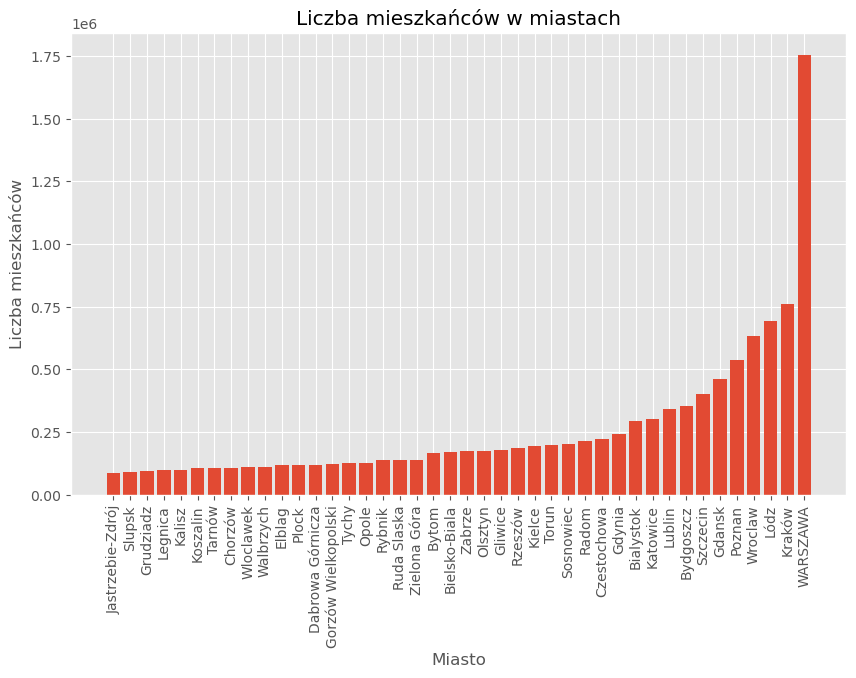

In [38]:
fig, ax = plt.subplots()

both2 = both.sort_values("Value")

ax.bar(both2.index, both2.Value)

ax.set_xlabel("Miasto")
ax.set_ylabel("Liczba mieszkańców")
ax.set_title("Liczba mieszkańców w miastach")

ax.xaxis.set_tick_params(rotation=90)

plt.style.use("ggplot") #zmiana stylu całego wykresu
# https://matplotlib.org/stable/gallery/style_sheets/style_sheets_reference.html

plt.show()

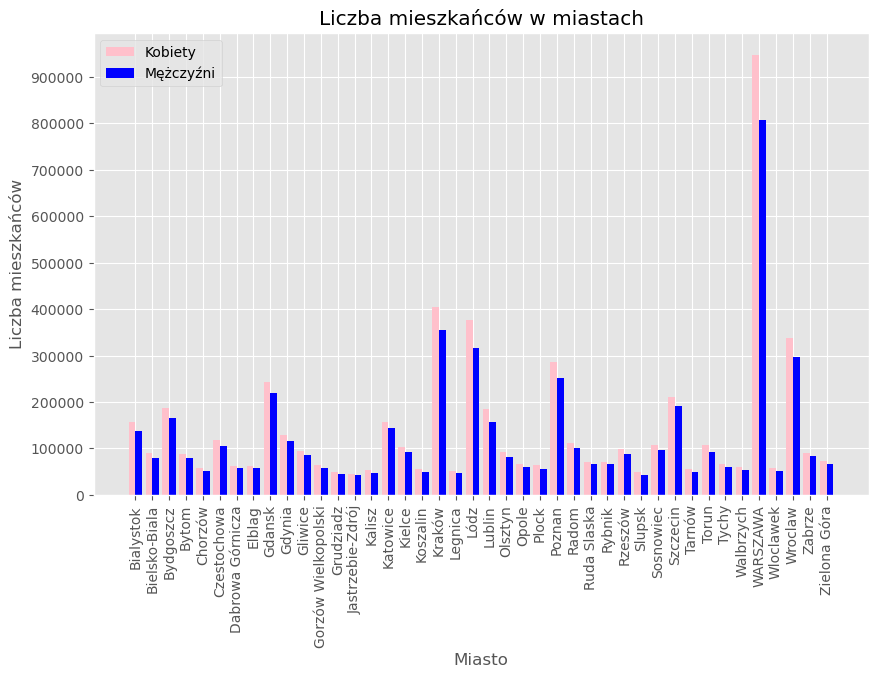

In [41]:
fig, ax = plt.subplots()

x = np.arange(len(female.index))
#print(x)

ax.bar(x-0.2, female.Value, label="Kobiety", color="pink", width=0.4)
ax.bar(x+0.2, male.Value, label="Mężczyźni", color="blue", width=0.4)

ax.set_xlabel("Miasto")
ax.set_ylabel("Liczba mieszkańców")
ax.set_title("Liczba mieszkańców w miastach")

ax.xaxis.set_tick_params(rotation=90)

plt.xticks(x, female.index) #przypisanie miast do labela X
plt.yticks(np.arange(0, max(female.Value)+1, 100000)) #zmiana częstości wyświetlania

plt.legend()
plt.show()

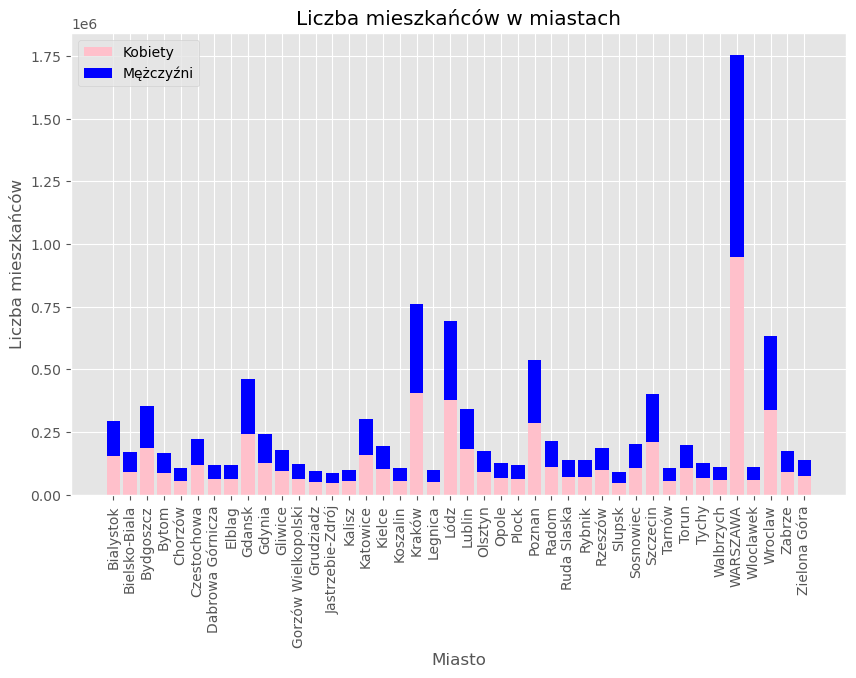

In [44]:
fig, ax = plt.subplots()

ax.bar(female.index, female.Value, label="Kobiety", color="pink", width=0.8)
ax.bar(male.index, male.Value, label="Mężczyźni", color="blue", width=0.8, bottom=female.Value)

ax.set_xlabel("Miasto")
ax.set_ylabel("Liczba mieszkańców")
ax.set_title("Liczba mieszkańców w miastach")

ax.xaxis.set_tick_params(rotation=90)

plt.legend()
plt.show()

In [45]:
wine = pd.read_csv("ML-datasets/wine.csv")
wine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178 entries, 0 to 177
Data columns (total 14 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Alcohol                       178 non-null    float64
 1   Malic acid                    178 non-null    float64
 2   Ash                           178 non-null    float64
 3   Alcalinity of ash             178 non-null    float64
 4   Magnesium                     178 non-null    int64  
 5   Total phenols                 178 non-null    float64
 6   Flavanoids                    178 non-null    float64
 7   Nonflavanoid phenols          178 non-null    float64
 8   Proanthocyanins               178 non-null    float64
 9   Color intensity               178 non-null    float64
 10  Hue                           178 non-null    float64
 11  OD280/OD315 of diluted wines  178 non-null    float64
 12  Proline                       178 non-null    int64  
 13  Class

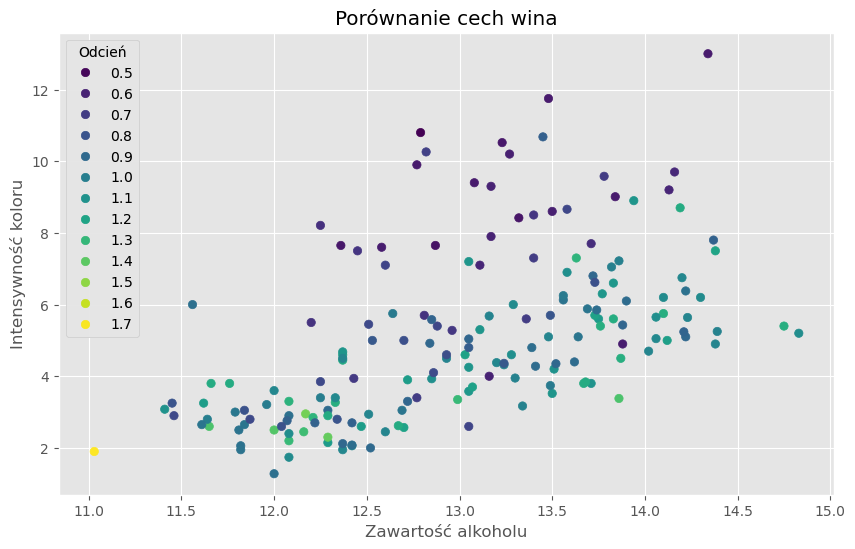

In [48]:
# wykres punktowy

fig, ax = plt.subplots()

scatter = ax.scatter(wine.Alcohol, wine["Color intensity"], c=wine.Hue)

ax.set_xlabel("Zawartość alkoholu")
ax.set_ylabel("Intensywność koloru")
ax.set_title("Porównanie cech wina")

legend = ax.legend(*scatter.legend_elements(), loc="best", title="Odcień")
ax.add_artist(legend)

plt.show()

## Seaborn

In [49]:
import seaborn as sns

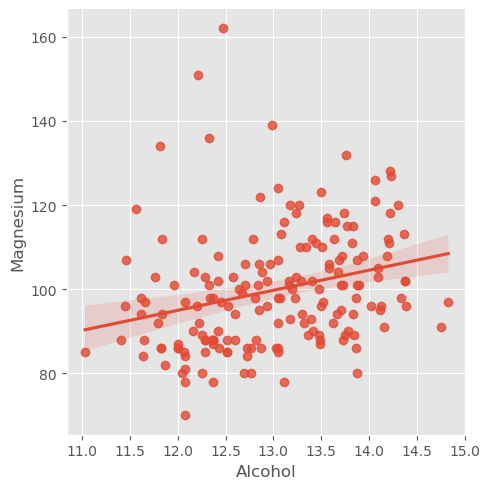

In [50]:
#wykres punktowy z linią regresji
sns.lmplot(x="Alcohol", y="Magnesium", data=wine)

(70.0, 140.0)

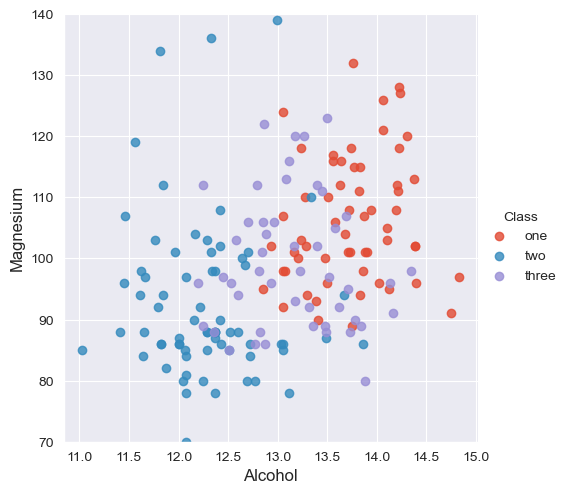

In [85]:
sns.set_style("darkgrid")
sns.lmplot(x="Alcohol", y="Magnesium", data=wine, hue="Class", fit_reg=False)
plt.ylim(70,140)

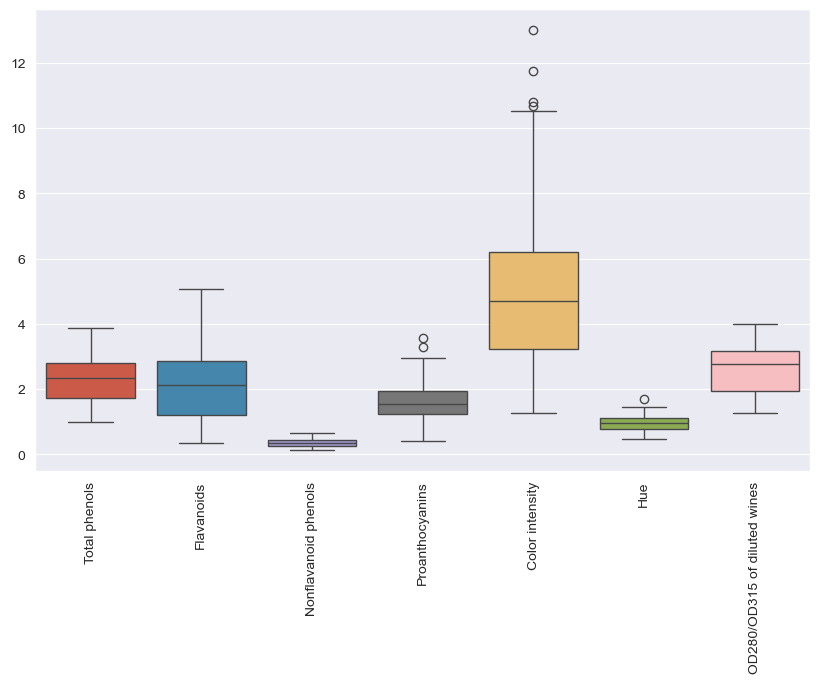

In [56]:
#boxplot
ax = sns.boxplot(data=wine.iloc[:,5:-2])
ax.xaxis.set_tick_params(rotation=90)

<AxesSubplot: xlabel='Class', ylabel='Alcohol'>

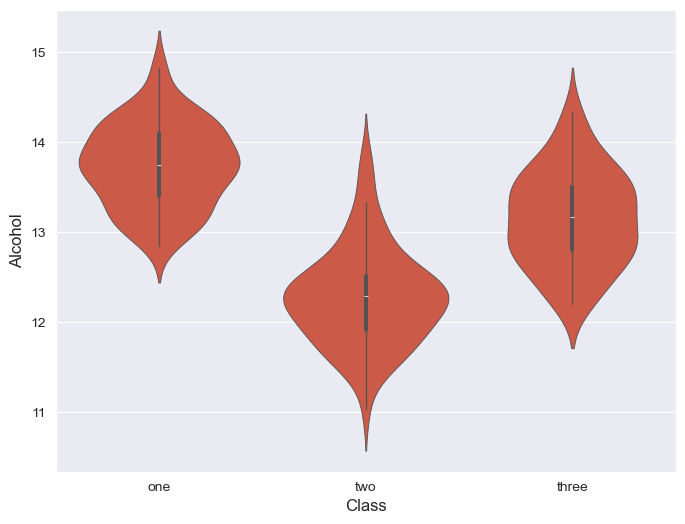

In [87]:
#wykres skrzypcowy
sns.violinplot(x="Class", y="Alcohol", data=wine)

<AxesSubplot: xlabel='Class', ylabel='Alcohol'>

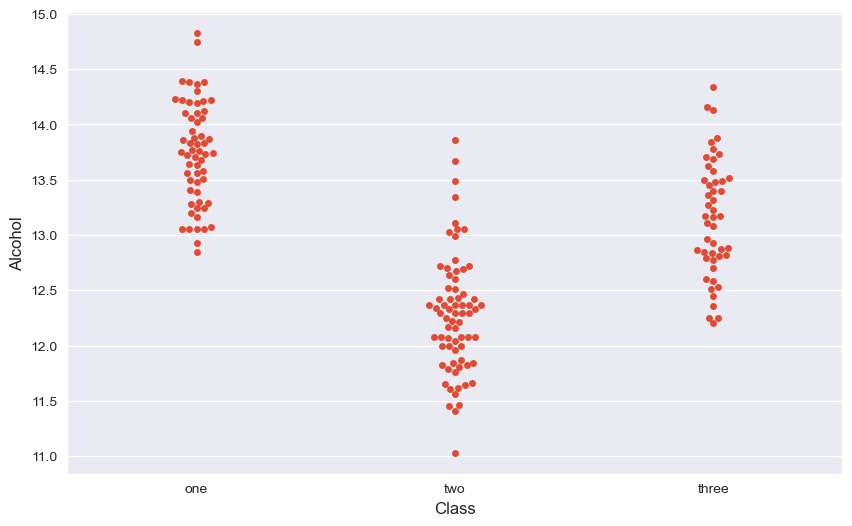

In [58]:
#wykres rojowy
sns.swarmplot(x="Class", y="Alcohol", data=wine)

Text(0.5, 1.0, 'Alkohol w zależności od typu wina')

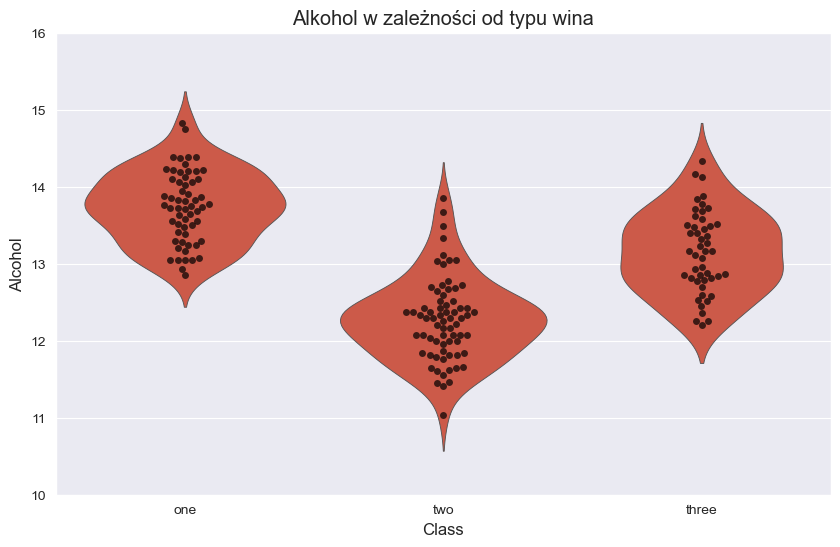

In [60]:
# połączenie wykresów
sns.violinplot(x="Class", y="Alcohol", data=wine, inner=None)
sns.swarmplot(x="Class", y="Alcohol", data=wine, color="black", alpha=0.7)
#plt.show()
#sns.swarmplot(x="Class", y="Alcohol", data=wine, color="black", alpha=0.7)
plt.ylim(10,16)
plt.title("Alkohol w zależności od typu wina")

In [61]:
wine.drop("Proline", axis=1, inplace=True)

In [62]:
wine.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 178 entries, 0 to 177
Data columns (total 13 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Alcohol                       178 non-null    float64
 1   Malic acid                    178 non-null    float64
 2   Ash                           178 non-null    float64
 3   Alcalinity of ash             178 non-null    float64
 4   Magnesium                     178 non-null    int64  
 5   Total phenols                 178 non-null    float64
 6   Flavanoids                    178 non-null    float64
 7   Nonflavanoid phenols          178 non-null    float64
 8   Proanthocyanins               178 non-null    float64
 9   Color intensity               178 non-null    float64
 10  Hue                           178 non-null    float64
 11  OD280/OD315 of diluted wines  178 non-null    float64
 12  Class                         178 non-null    object 
dtypes: fl

In [63]:
wine.iloc[:,5:].head()

,Total phenols,Flavanoids,Nonflavanoid phenols,Proanthocyanins,Color intensity,Hue,OD280/OD315 of diluted wines,Class
0,2.80,3.06,0.28,2.29,5.64,1.04,3.92,one
1,2.65,2.76,0.26,1.28,4.38,1.05,3.40,one
2,2.80,3.24,0.30,2.81,5.68,1.03,3.17,one
3,3.85,3.49,0.24,2.18,7.80,0.86,3.45,one
4,2.80,2.69,0.39,1.82,4.32,1.04,2.93,one


In [64]:
melted = pd.melt(wine.iloc[:,5:], id_vars="Class", var_name="Stat")
melted

,Class,Stat,value
0,one,Total phenols,2.80
1,one,Total phenols,2.65
2,one,Total phenols,2.80
3,one,Total phenols,3.85
4,one,Total phenols,2.80
...,...,...,...
1241,three,OD280/OD315 of diluted wines,1.74
1242,three,OD280/OD315 of diluted wines,1.56
1243,three,OD280/OD315 of diluted wines,1.56
1244,three,OD280/OD315 of diluted wines,1.62


In [65]:
print(len(wine))
print(len(melted))

178
1246


/opt/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 29.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/opt/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 11.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/opt/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 78.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/opt/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 34.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/opt/anaconda3/lib/python3.9/site-packages/seaborn/categorical.py:3399: UserWarning: 65.7% of the points

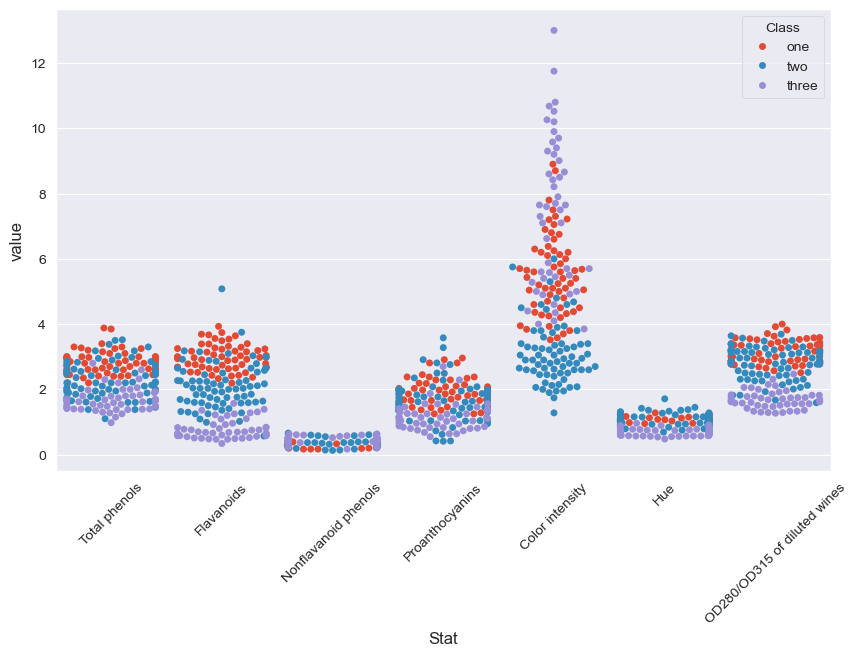

In [66]:
wykres = sns.swarmplot(x="Stat", y="value", data=melted, hue="Class")
wykres.xaxis.set_tick_params(rotation=45)

In [67]:
sns.__version__

'0.13.2'

In [68]:
matplotlib.rcParams["figure.figsize"] = [16,12]
wine.drop("Class", axis=1, inplace=True)

<AxesSubplot: >

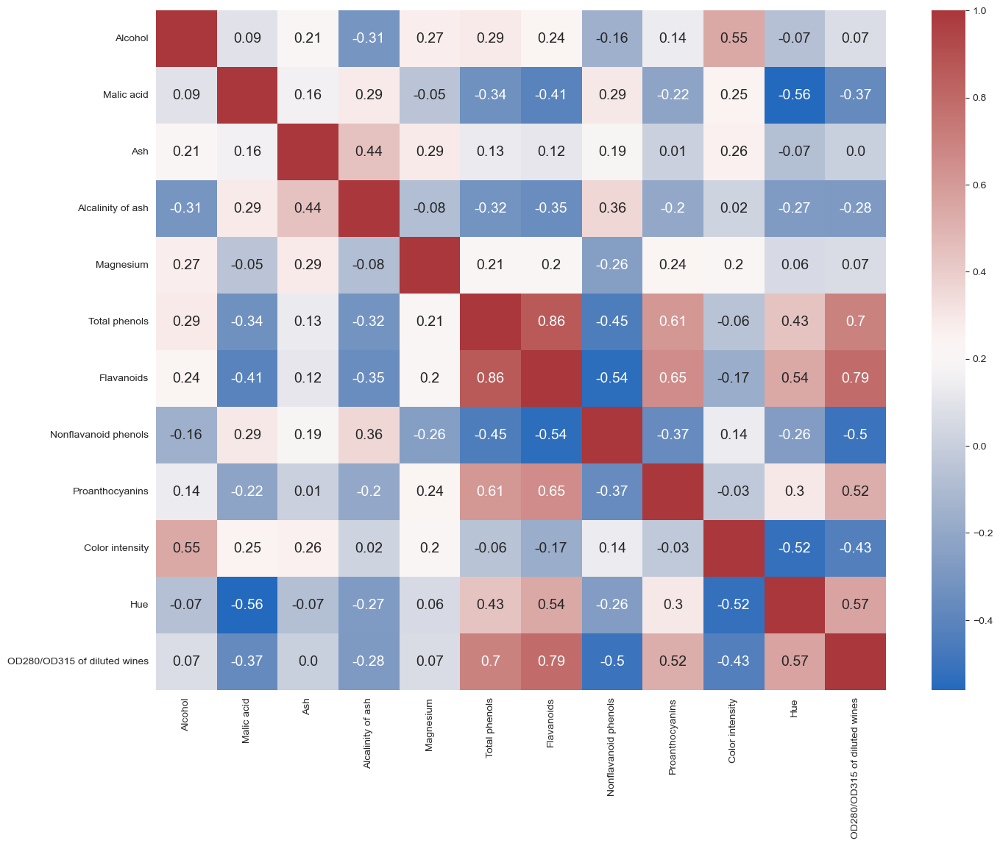

In [77]:
# heatmap
corr = wine.corr()
labels = corr.map(lambda x: str(round(x,2)) if x != 1 else "") # map dla dataframe'u bierze pojedyncze elementy
#display(labels)
sns.heatmap(corr, annot=labels, cmap="vlag", fmt='', annot_kws={"fontsize":14}) #annot=True

<AxesSubplot: xlabel='Alcohol', ylabel='Count'>

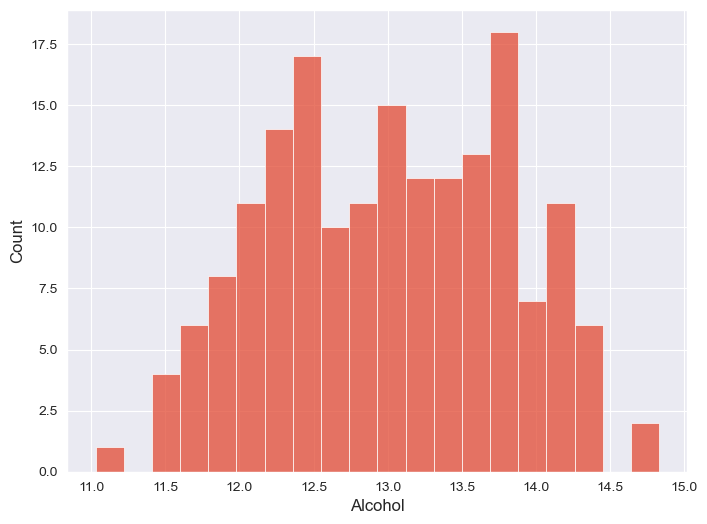

In [80]:
#histogram
matplotlib.rcParams["figure.figsize"] = [8,6]
sns.histplot(wine.Alcohol, bins=20)

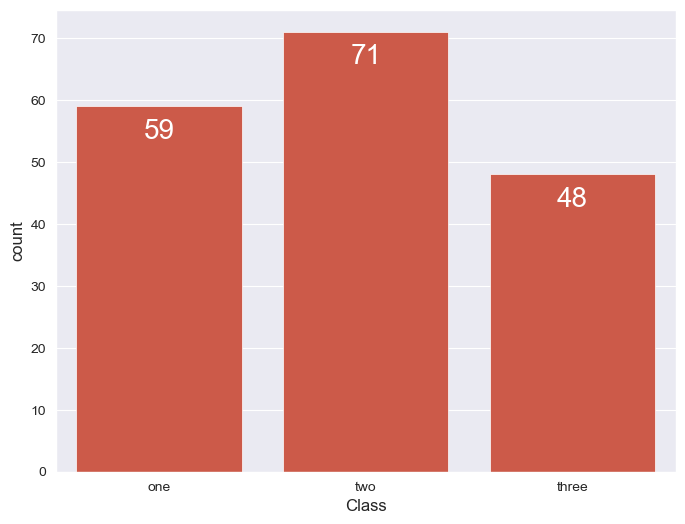

In [84]:
#wykres słupkowy
wine = pd.read_csv("ML-datasets-master/wine.csv")
wykres = sns.countplot(x="Class", data=wine)
for i in wykres.patches:
    wykres.annotate(round(i.get_height()), (i.get_x()+0.4, i.get_height()-2), ha="center", va="top", color="white", size=20)

<AxesSubplot: xlabel='Alcohol', ylabel='Magnesium'>

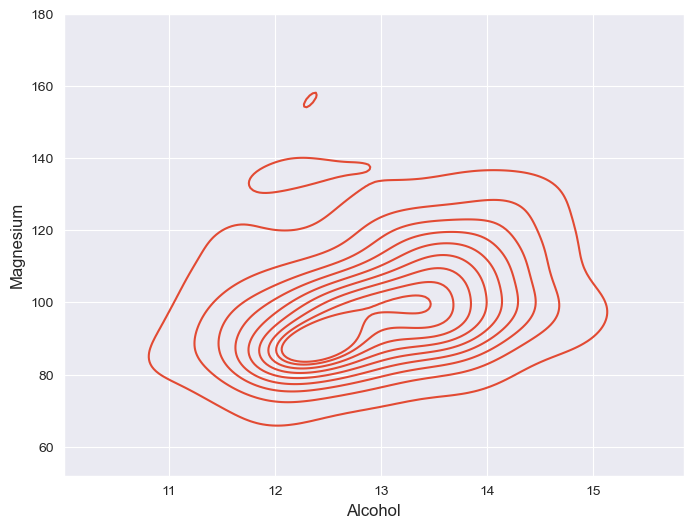

In [90]:
#wykres gęstościowy
#sns.lmplot(data=wine, x="Alcohol", y="Magnesium")
sns.kdeplot(data=wine, x="Alcohol", y="Magnesium")

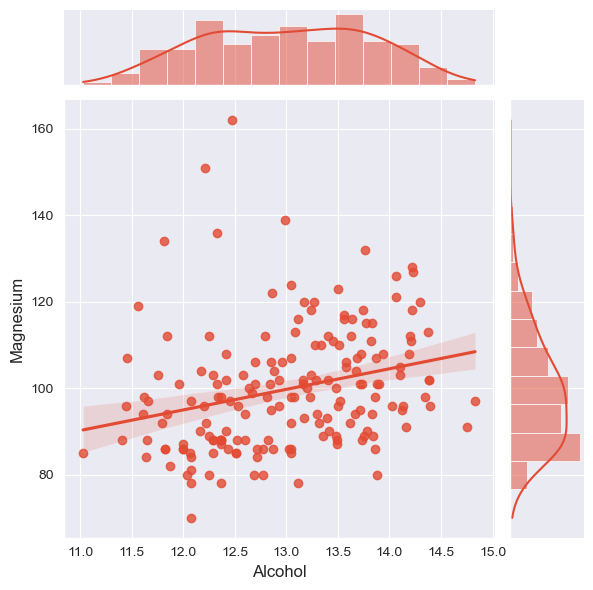

In [91]:
ax = sns.jointplot(data=wine, x="Alcohol", y="Magnesium", kind="reg", marginal_kws={"bins": 14})
# zapisywanie obrazka
ax.fig.savefig("output.png")

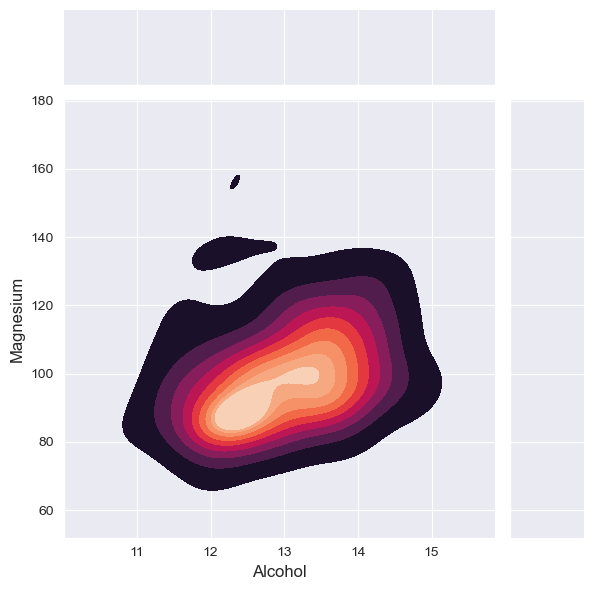

In [92]:
g = sns.JointGrid(data=wine, x="Alcohol", y="Magnesium")
g.plot_joint(sns.kdeplot, fill=True, cmap="rocket")

## Plotly

In [95]:
import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import iplot
import pandas as pd

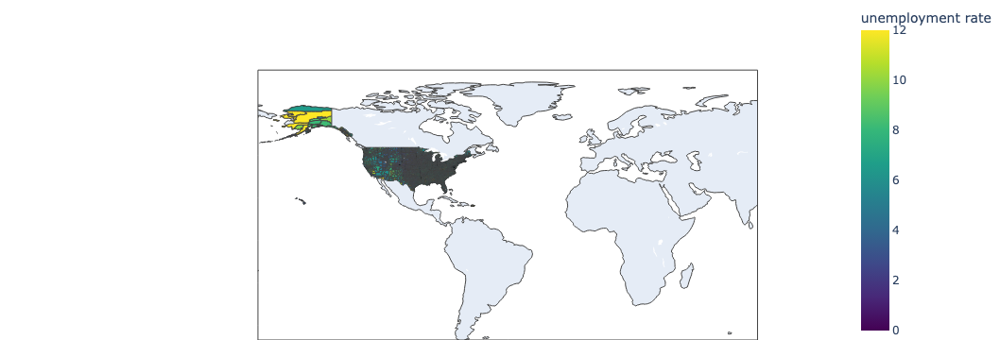

In [94]:
from urllib.request import urlopen
import json
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

import pandas as pd
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

import plotly.express as px

fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                         center = {"lat": 37.0902, "lon": -95.7129},
                           labels={'unemp':'unemployment rate'}
                          )
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

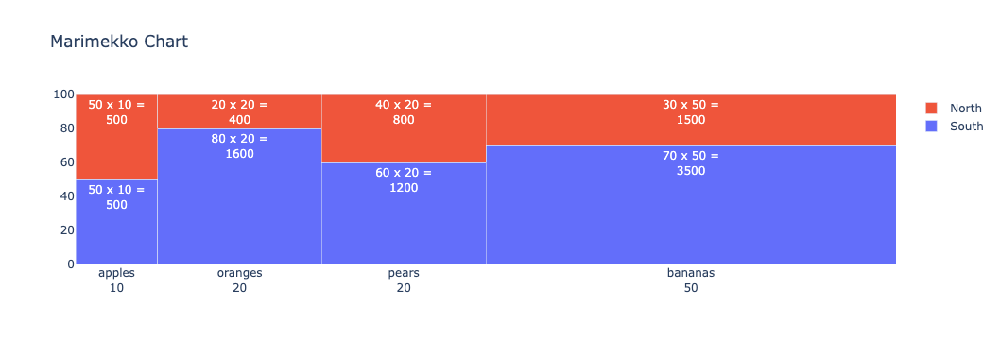

In [98]:
import plotly.graph_objects as go
import numpy as np

labels = ["apples","oranges","pears","bananas"]
widths = np.array([10,20,20,50])

data = {
    "South": [50,80,60,70],
    "North": [50,20,40,30]
}

fig = go.Figure()
for key in data:
    fig.add_trace(go.Bar(
        name=key,
        y=data[key],
        x=np.cumsum(widths)-widths,
        width=widths,
        offset=0,
        customdata=np.transpose([labels, widths*data[key]]),
        texttemplate="%{y} x %{width} =<br>%{customdata[1]}",
        textposition="inside",
        textangle=0,
        textfont_color="white",
        hovertemplate="<br>".join([
            "label: %{customdata[0]}",
            "width: %{width}",
            "height: %{y}",
            "area: %{customdata[1]}",
        ])
    ))

fig.update_xaxes(
    tickvals=np.cumsum(widths)-widths/2,
    ticktext= ["%s<br>%d" % (l, w) for l, w in zip(labels, widths)]
)

fig.update_xaxes(range=[0,100])
fig.update_yaxes(range=[0,100])

fig.update_layout(
    title_text="Marimekko Chart",
    barmode="stack",
    uniformtext=dict(mode="hide", minsize=10),
)

In [99]:
#!git clone https://github.com/matzim95/ML-datasets
university = pd.read_csv("ML-datasets-master/timesData.csv", na_values="-")
university.head()

,world_rank,university_name,country,teaching,international,research,citations,income,total_score,num_students,student_staff_ratio,international_students,female_male_ratio,year
0,1,Harvard University,United States of America,99.7,72.4,98.7,98.8,34.5,96.1,"20,152",8.9,25%,NaN,2011
1,2,California Institute of Technology,United States of America,97.7,54.6,98.0,99.9,83.7,96.0,"2,243",6.9,27%,33 : 67,2011
2,3,Massachusetts Institute of Technology,United States of America,97.8,82.3,91.4,99.9,87.5,95.6,"11,074",9.0,33%,37 : 63,2011
3,4,Stanford University,United States of America,98.3,29.5,98.1,99.2,64.3,94.3,"15,596",7.8,22%,42 : 58,2011
4,5,Princeton University,United States of America,90.9,70.3,95.4,99.9,NaN,94.2,"7,929",8.4,27%,45 : 55,2011


In [100]:
university.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2603 entries, 0 to 2602
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   world_rank              2603 non-null   object 
 1   university_name         2603 non-null   object 
 2   country                 2603 non-null   object 
 3   teaching                2603 non-null   float64
 4   international           2594 non-null   float64
 5   research                2603 non-null   float64
 6   citations               2603 non-null   float64
 7   income                  2385 non-null   float64
 8   total_score             1201 non-null   float64
 9   num_students            2544 non-null   object 
 10  student_staff_ratio     2544 non-null   float64
 11  international_students  2536 non-null   object 
 12  female_male_ratio       2367 non-null   object 
 13  year                    2603 non-null   int64  
dtypes: float64(7), int64(1), object(6)
memor

In [101]:
university[university.country == "Poland"]

,world_rank,university_name,country,teaching,international,research,citations,income,total_score,num_students,student_staff_ratio,international_students,female_male_ratio,year
511,301-350,Jagiellonian University,Poland,25.1,39.5,16.0,43.1,25.8,NaN,"42,835",11.5,5%,67 : 33,2012
546,301-350,University of Warsaw,Poland,21.6,35.8,15.7,44.3,NaN,NaN,"49,292",14.1,7%,67 : 33,2012
960,351-400,Jagiellonian University,Poland,22.7,41.7,13.8,48.2,29.5,NaN,"42,835",11.5,5%,67 : 33,2013
999,351-400,University of Warsaw,Poland,23.2,39.8,18.4,54.0,27.9,NaN,"49,292",14.1,7%,67 : 33,2013
1350,301-350,University of Warsaw,Poland,18.7,42.8,14.3,71.1,28.3,NaN,"49,292",14.1,7%,67 : 33,2014
1750,301-350,University of Warsaw,Poland,20.8,41.6,13.6,70.0,28.5,NaN,"49,292",14.1,7%,67 : 33,2015
2399,501-600,University of Warsaw,Poland,26.1,41.6,15.8,42.2,28.5,NaN,"49,292",14.1,7%,67 : 33,2016
2404,601-800,Adam Mickiewicz University,Poland,20.0,25.7,11.0,15.3,28.7,NaN,"40,633",15.6,1%,71 : 29,2016
2405,601-800,AGH University of Science and Technology,Poland,14.2,17.9,3.7,35.7,NaN,NaN,"35,569",17.0,1%,NaN,2016
2473,601-800,Gdańsk University of Technology,Poland,15.5,16.1,9.5,15.2,36.8,NaN,"25,217",23.3,1%,39 : 61,2016


In [102]:
df = university.loc[:100,:]

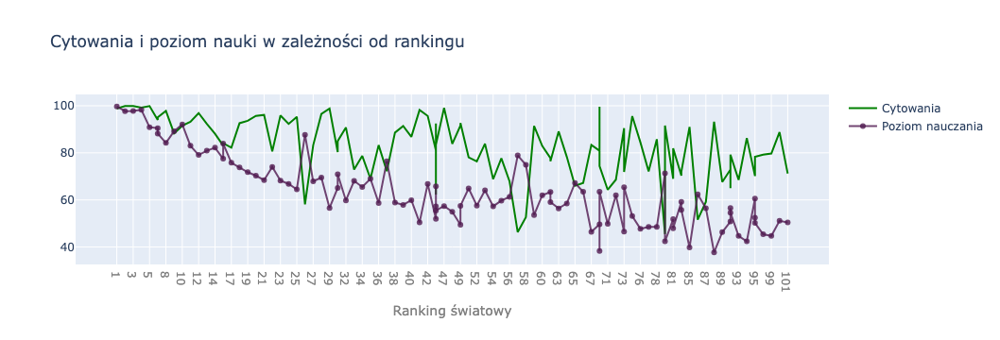

In [134]:
#wykres punktowo liniowy

#wykres
trace1 = go.Scatter(x=df.world_rank, y=df.citations, mode="lines", name="Cytowania",
                    marker={"color": "green"}, text=df.university_name)

trace2 = go.Scatter(x=df.world_rank, y=df.teaching, mode="lines+markers", name="Poziom nauczania",
                    marker={"color": "rgba(80,26,80,0.8)"}, text=df.university_name)

#layout

layout = {"title": "Cytowania i poziom nauki w zależności od rankingu",
          "xaxis": {"title": "Ranking światowy", "color": "gray"}}


fig = {"data": [trace1, trace2], "layout": layout}
#fig = go.Figure(data=[trace1, trace2], layout=layout)
#fig.write_html("wykres.html")
iplot(fig)

In [ ]:
trace2

In [ ]:
fig

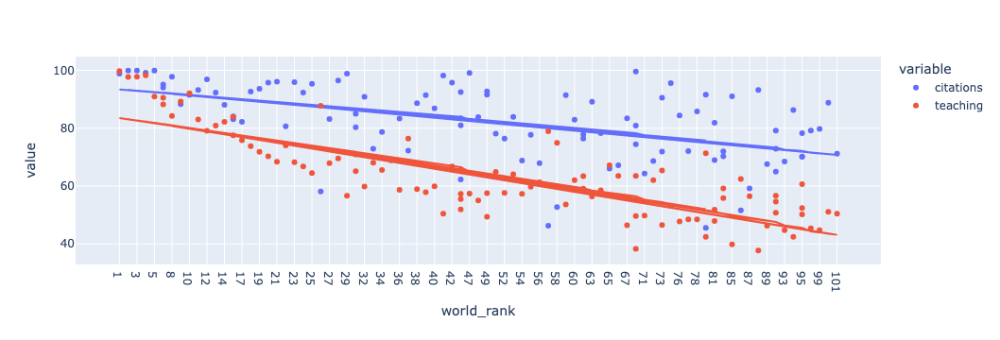

In [120]:
px.scatter(df, x="world_rank", y=["citations", "teaching"], trendline="ols")

In [121]:
#plotly express
fig = px.scatter(df, x="world_rank", y=["citations", "teaching"], trendline="ols")
results = px.get_trendline_results(fig)
#display(results)
results = results.iloc[0]["px_fit_results"].summary()
print(results)

                            OLS Regression Results                            
Dep. Variable:                      y   R-squared:                       0.268
Model:                            OLS   Adj. R-squared:                  0.261
Method:                 Least Squares   F-statistic:                     36.23
Date:                Wed, 20 Nov 2024   Prob (F-statistic):           2.98e-08
Time:                        11:27:35   Log-Likelihood:                -384.28
No. Observations:                 101   AIC:                             772.6
Df Residuals:                      99   BIC:                             777.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         93.6350      2.199     42.584      0.0

In [122]:
df2014 = university[university.year == 2014].iloc[:30,:]
df2015 = university[university.year == 2015].iloc[:30,:]
df2016 = university[university.year == 2016].iloc[:30,:]

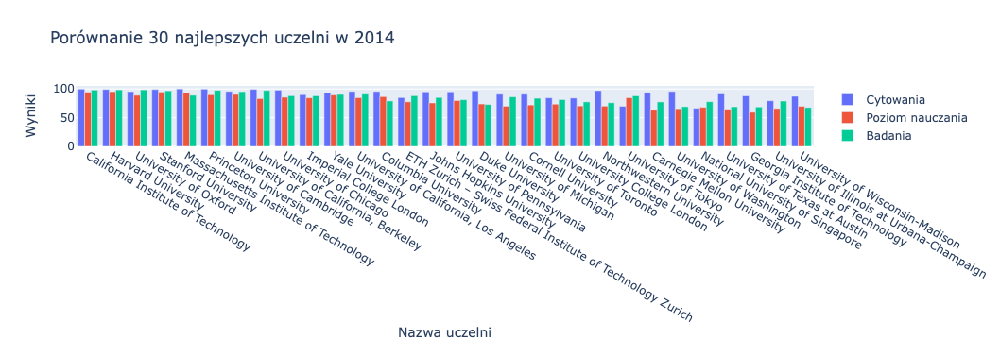

In [126]:
# wykres słupkowy

#wykres

trace1 = go.Bar(x=df2014.university_name, y=df2014.citations, name="Cytowania")
trace2 = go.Bar(x=df2014.university_name, y=df2014.teaching, name="Poziom nauczania")
trace3 = go.Bar(x=df2014.university_name, y=df2014.research, name="Badania")


#wygląd

layout = {"title": "Porównanie 30 najlepszych uczelni w 2014",
          "barmode": "group",
          "xaxis": {"title": "Nazwa uczelni"},
          "yaxis": {"title": "Wyniki"}}

#fig = {"data": [trace1, trace2, trace3], "layout": layout}
fig = go.Figure(data=[trace1, trace2, trace3], layout=layout)
iplot(fig)

In [127]:
fig.write_html("wykres.html")

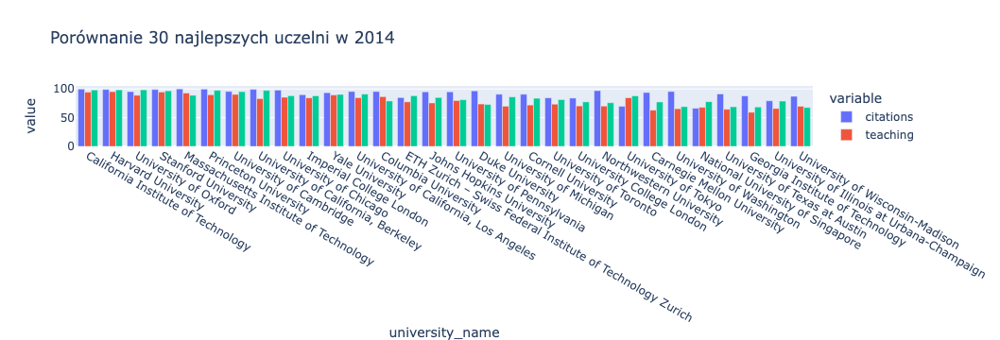

In [128]:
#ten sam wykres w plotly express
px.bar(df2014, x="university_name", y=["citations", "teaching", "research"], title="Porównanie 30 najlepszych uczelni w 2014", barmode="group")

In [131]:
df2016_2 = df2016.iloc[:7,:]
students = df2016_2.num_students
students
students_list = [int(x.replace(",", "")) for x in students]
students_list

[2243, 19919, 15596, 18812, 11074, 20152, 7929]

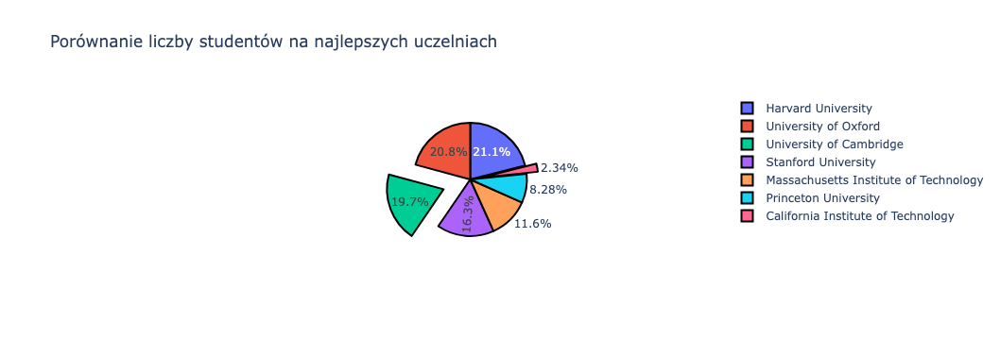

In [140]:
#wykres kołowy
fig = {
    "data": [
        {
            "type": "pie",
            "values": students_list,
            "labels": df2016_2.university_name,
            "hoverinfo": "label+percent",
            "marker": {"line": {"color": "#000000", "width": 2}},
            "pull": [0.2, 0, 0, 0.5, 0, 0, 0]
        }
    ],
    "layout": {
        "title": "Porównanie liczby studentów na najlepszych uczelniach"
    }
}

iplot(fig)

In [141]:
university.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2603 entries, 0 to 2602
Data columns (total 14 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   world_rank              2603 non-null   object 
 1   university_name         2603 non-null   object 
 2   country                 2603 non-null   object 
 3   teaching                2603 non-null   float64
 4   international           2594 non-null   float64
 5   research                2603 non-null   float64
 6   citations               2603 non-null   float64
 7   income                  2385 non-null   float64
 8   total_score             1201 non-null   float64
 9   num_students            2544 non-null   object 
 10  student_staff_ratio     2544 non-null   float64
 11  international_students  2536 non-null   object 
 12  female_male_ratio       2367 non-null   object 
 13  year                    2603 non-null   int64  
dtypes: float64(7), int64(1), object(6)
memor

In [142]:
df2011 = university.student_staff_ratio[university.year == 2011][:100]
df2012 = university.student_staff_ratio[university.year == 2012][:100]

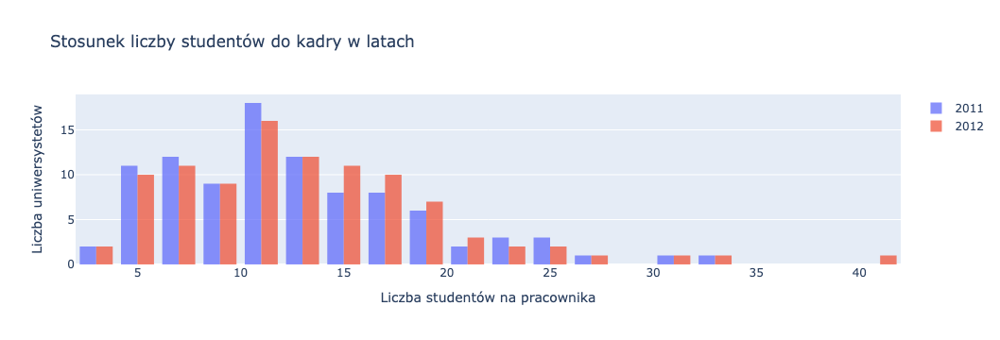

In [143]:
# histogram

trace1 = go.Histogram(x=df2011, name="2011", opacity=0.75)
trace2 = go.Histogram(x=df2012, name="2012", opacity=0.75)

layout = go.Layout(title="Stosunek liczby studentów do kadry w latach",
                   barmode="group",
                   xaxis={"title": "Liczba studentów na pracownika"},
                   yaxis={"title": "Liczba uniwersystetów"})

fig = go.Figure(data=[trace1, trace2], layout=layout)
iplot(fig)

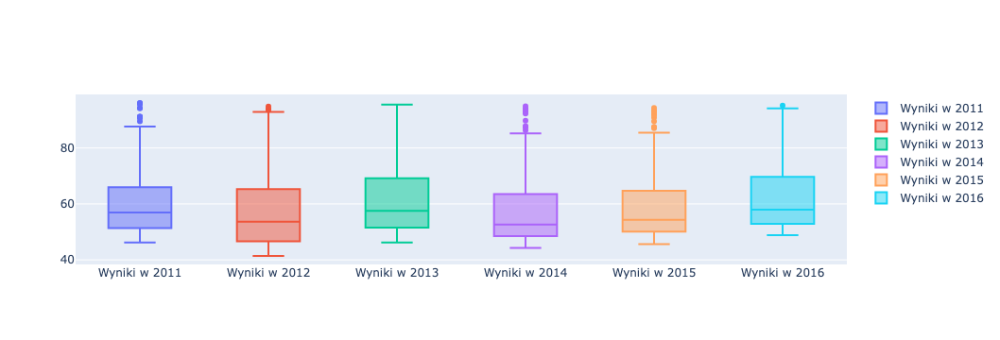

In [144]:
#boxplot
trace1 = go.Box(y=university[university.year==2011].total_score.astype(float), name="Wyniki w 2011")
trace2 = go.Box(y=university[university.year==2012].total_score.astype(float), name="Wyniki w 2012")
trace3 = go.Box(y=university[university.year==2013].total_score.astype(float), name="Wyniki w 2013")
trace4 = go.Box(y=university[university.year==2014].total_score.astype(float), name="Wyniki w 2014")
trace5 = go.Box(y=university[university.year==2015].total_score.astype(float), name="Wyniki w 2015")
trace6 = go.Box(y=university[university.year==2016].total_score.astype(float), name="Wyniki w 2016")

iplot([trace1,trace2,trace3,trace4,trace5,trace6])

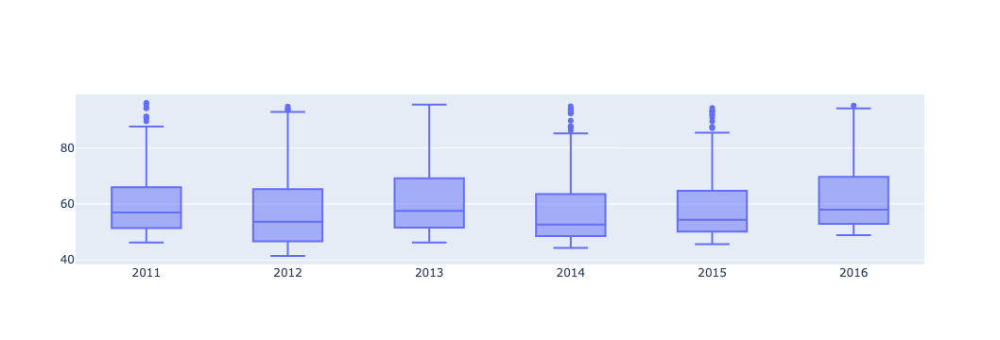

In [145]:
trace = go.Box(x=university.year, y=university.total_score.astype(float), name="Wyniki")
iplot([trace])

In [146]:
df2014_3 = df2014.iloc[:,3:9].reset_index(drop=True)
df2014_3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30 entries, 0 to 29
Data columns (total 6 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   teaching       30 non-null     float64
 1   international  30 non-null     float64
 2   research       30 non-null     float64
 3   citations      30 non-null     float64
 4   income         26 non-null     float64
 5   total_score    30 non-null     float64
dtypes: float64(6)
memory usage: 1.5 KB


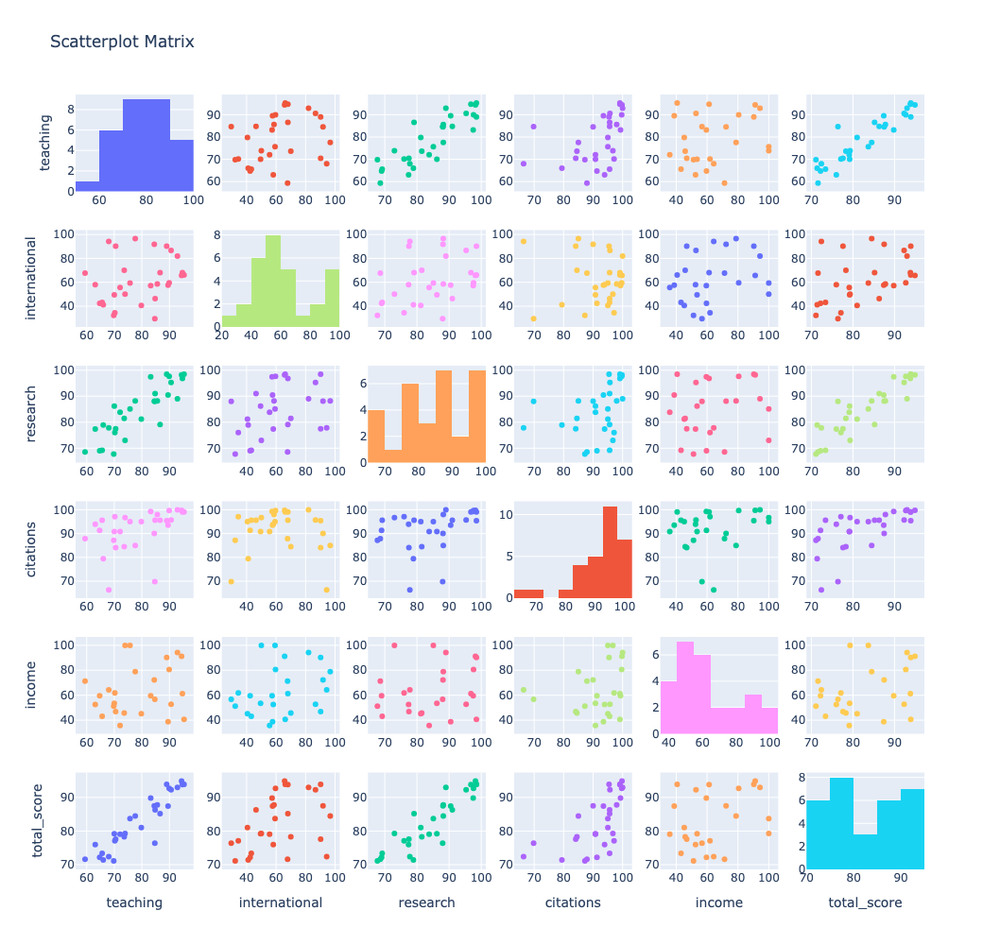

In [161]:
import plotly.figure_factory as ff

fig = ff.create_scatterplotmatrix(df2014_3, height=1000, width=1000, diag="histogram")
iplot(fig)

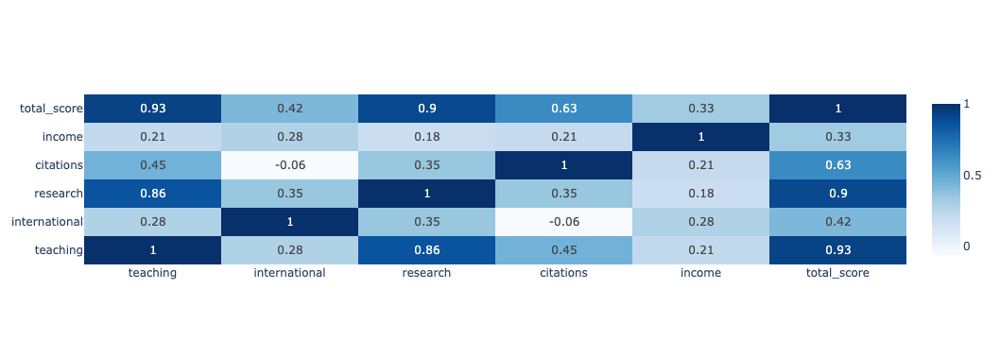

In [159]:
#heatmapa

corr = df2014_3.corr()

fig = go.Figure(data=go.Heatmap(x=df2014_3.columns, y=df2014_3.columns, z=corr, colorscale="Blues", text=round(corr,2), texttemplate="%{text}"))
iplot(fig)

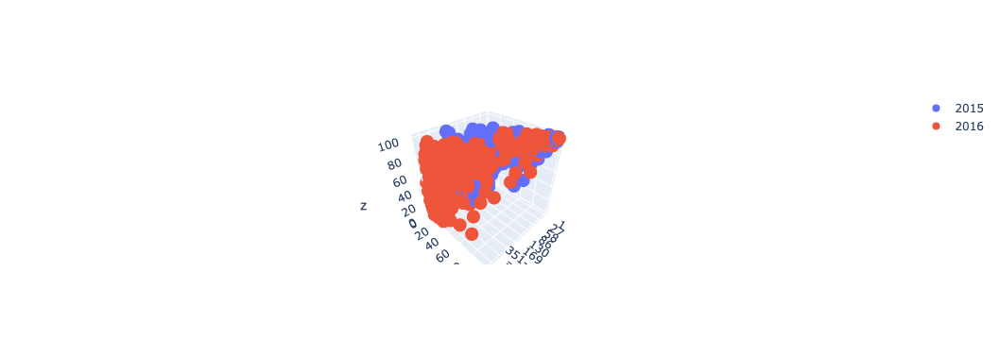

In [162]:
#wykres3D

df2015 = university[university.year == 2015]
df2016 = university[university.year == 2016]

trace1 = go.Scatter3d(x=df2015.world_rank, y=df2015.research.astype(float), z=df2015.citations.astype(float),
                      mode="markers", text=df2015.university_name, name="2015")
trace2 = go.Scatter3d(x=df2016.world_rank, y=df2016.research.astype(float), z=df2016.citations.astype(float),
                      mode="markers", text=df2016.university_name, name="2016")

fig = go.Figure(data=[trace1, trace2])
iplot(fig)

In [ ]:
!pip install wordcloud

In [165]:
#" ".join(university.country)

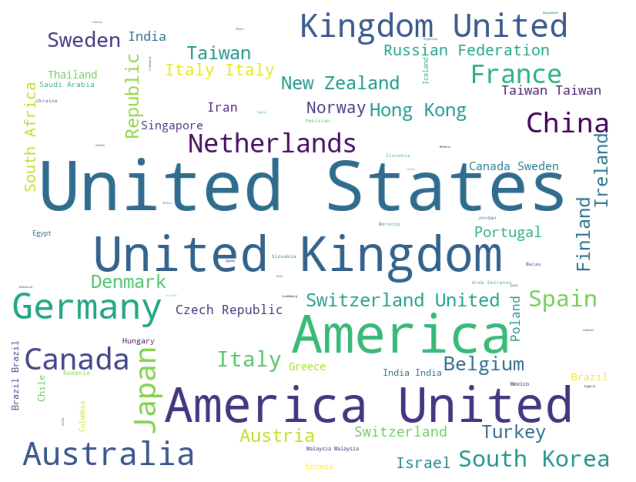

In [166]:
#wordcloud

from wordcloud import WordCloud
import matplotlib.pyplot as plt

countries = WordCloud(background_color="white", width=800, height=600)
countries.generate(" ".join(university.country))
plt.grid()
plt.axis("off")
plt.imshow(countries)

## Plotly Dash

In [168]:
from dash import Dash, dcc, html

df2015 = university[university.year == 2015]
df2016 = university[university.year == 2016]

trace1 = go.Scatter3d(x=df2015.world_rank, y=df2015.research.astype(float), z=df2015.citations.astype(float),
                      mode="markers", text=df2015.university_name, name="2015")
trace2 = go.Scatter3d(x=df2016.world_rank, y=df2016.research.astype(float), z=df2016.citations.astype(float),
                      mode="markers", text=df2016.university_name, name="2016")

fig = go.Figure(data=[trace1, trace2])

app = Dash()
app.layout = html.Div([
    dcc.Graph(figure=fig)
])

app.run_server(debug=True, use_reloader=False, port=8051)

In [171]:
# przygotowanie danych

whisky = pd.read_csv("ML-datasets-master/whisky.csv")

whisky = whisky.groupby(["Region", "Smoky"])["Smoky"].count().reset_index(name="count")

regions = whisky["Region"].unique()

data = []
for region in regions:
    temp = {}
    temp["x"] = list(whisky[whisky["Region"] == region]["Smoky"])
    temp["y"] = list(whisky[whisky["Region"] == region]["count"])
    temp["type"] = "bar"
    temp["name"] = region
    temp["text"] = region
    data.append(temp)

data

[{'x': [0, 1, 2, 3],
  'y': [2, 9, 17, 3],
  'type': 'bar',
  'name': 'Highland',
  'text': 'Highland'},
 {'x': [1, 2, 3, 4],
  'y': [3, 2, 2, 4],
  'type': 'bar',
  'name': 'Islay & Islands',
  'text': 'Islay & Islands'},
 {'x': [0, 1],
  'y': [1, 2],
  'type': 'bar',
  'name': 'Lowland',
  'text': 'Lowland'},
 {'x': [0, 1, 2],
  'y': [1, 31, 9],
  'type': 'bar',
  'name': 'Speyside',
  'text': 'Speyside'}]

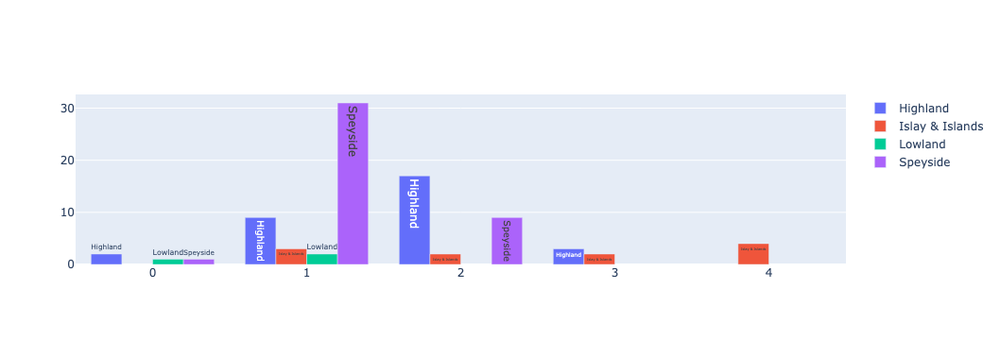

In [172]:
iplot(data)

In [ ]:
!pip install dash
!pip install dash_core_components
!pip install dash_html_components

In [173]:
import pandas as pd
import dash #tworzenie serwera aplikacji webowej - Flask
from dash import dcc #załączanie plotly go i px - umożliwia tworzenie wykresów
from dash import html #umożliwia tworzenie frontendu aplikacji (kod html)

whisky = pd.read_csv("ML-datasets-master/whisky.csv")

whisky = whisky.groupby(["Region", "Smoky"])["Smoky"].count().reset_index(name="count")

regions = whisky["Region"].unique()

data = []
for region in regions:
    temp = {}
    temp["x"] = list(whisky[whisky["Region"] == region]["Smoky"])
    temp["y"] = list(whisky[whisky["Region"] == region]["count"])
    temp["type"] = "bar"
    temp["name"] = region
    temp["text"] = region
    data.append(temp)

#definicja serwera aplikacji webowej - Flask
app = dash.Dash()

#przygotowanie contentu
app.layout = html.Div(children=[
    html.H1(children="Wykres słupkowy ze statystyką Szkockich destylarni"),
    html.H3(children="Na wykresie zliczamy destylarnie w Szkocji w zależności od dymności whisky"),
    dcc.Graph(id="whisky-barchart",
              figure={
                  "data": data,
                  "layout": {
                      "title": "Dymność whisky w zależności od regionu",
                      "xaxis": {"title": "Skala dymności"},
                      "yaxis": {"title": "Liczba destylarni"}
                  }
              })
])

#start aplikacji
app.run_server(debug=True, port=8051)